## <span style='color:#ff5f27'> 📝 Imports</span>

In [1]:
import torch
import matplotlib.pyplot as plt
from PIL import Image
import IPython.display as play

from functions.utils import(
    clear_folder,
    show_pil_image,
    show_segmentation,
    show_image,
    show_decoded_vector,
    save_image,
    create_gif,
)
from functions.vqgan import (
    load_vqgan_model,
    load_and_process_segmentation,
    generate_image,
    load_process_encode_rgb_image,
    show_original_and_reconstruction,
)
from functions.t5 import encode_text
import config

## <span style='color:#ff5f27'> 🤖 Model Loading</span>

In [2]:
# Load COCO VQGAN
vqgan_model = load_vqgan_model(
    config.VQGAN_CONFIG_SFLCKR,
    config.VQGAN_CHECKPOINT_SFLCKR,
).to(config.DEVICE)

Working with z of shape (1, 256, 16, 16) = 65536 dimensions.
Working with z of shape (1, 256, 16, 16) = 65536 dimensions.
2024-09-10 16:11:25,297 INFO: number of parameters: 3.049329e+08
Restored from logs/2020-11-09T13-31-51_sflckr/model_ckpt/last.ckpt
✅ Done!


## <span style='color:#ff5f27'> 🧬 Settings</span>

In [3]:
# Set the random seed for reproducibility
if config.SEED is None:
    seed = torch.seed()
else:
    seed = config.SEED
torch.manual_seed(seed)
print('⛳️ Using seed:', seed)

# Print the device being used (CPU or GPU)
print('🚀 Using device:', config.DEVICE)

⛳️ Using seed: 6600167715585205386
🚀 Using device: cuda:0


- 000000098392

- 000000128658

- 000000119445

- 000000154358

- 000000335529

- 000000348481

- 000000403385

- 000000522393

- 000000052507

- 000000237928

## <span style='color:#ff5f27'> ⚙️ Image Reconstruction</span>

/srv/hops/anaconda/envs/theenv/lib/python3.10/site-packages/torchvision/transforms/functional.py:442: UserWarning: Argument 'interpolation' of type int is deprecated since 0.13 and will be removed in 0.15. Please use InterpolationMode enum.
  warnings.warn(


⛳️ Image continuous latent vector Shape: torch.Size([1, 256, 16, 16])


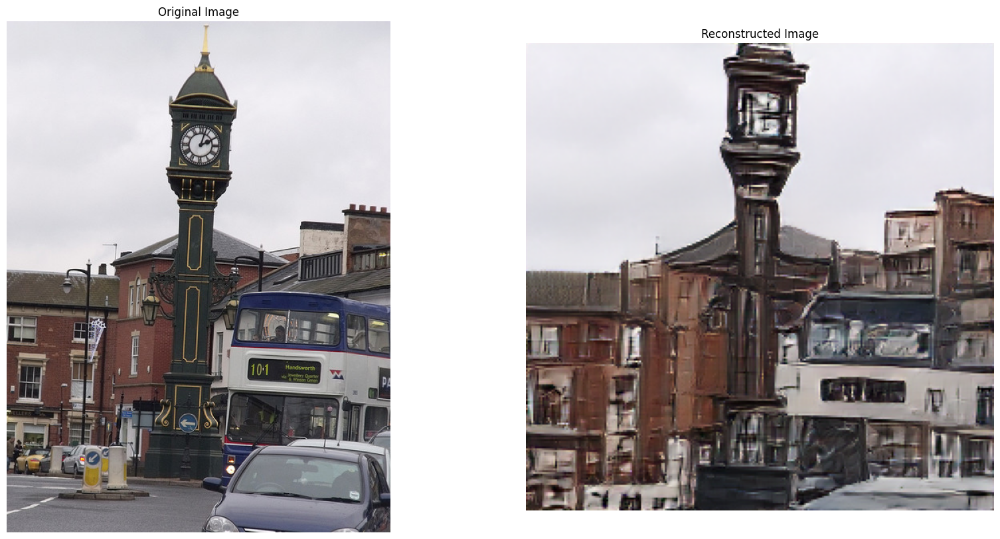

In [4]:
IMAGE_ID = "000000098392"

IMAGE_PATH = f"mc_coco/val2017/{IMAGE_ID}.jpg"

z, c_indices, x_rec = load_process_encode_rgb_image(IMAGE_PATH, vqgan_model, return_reconstruct=True, device=config.DEVICE)

print(f'⛳️ Image continuous latent vector Shape: {z.shape}')

show_original_and_reconstruction(IMAGE_PATH, x_rec)

⛳️ Image continuous latent vector Shape: torch.Size([1, 256, 16, 16])


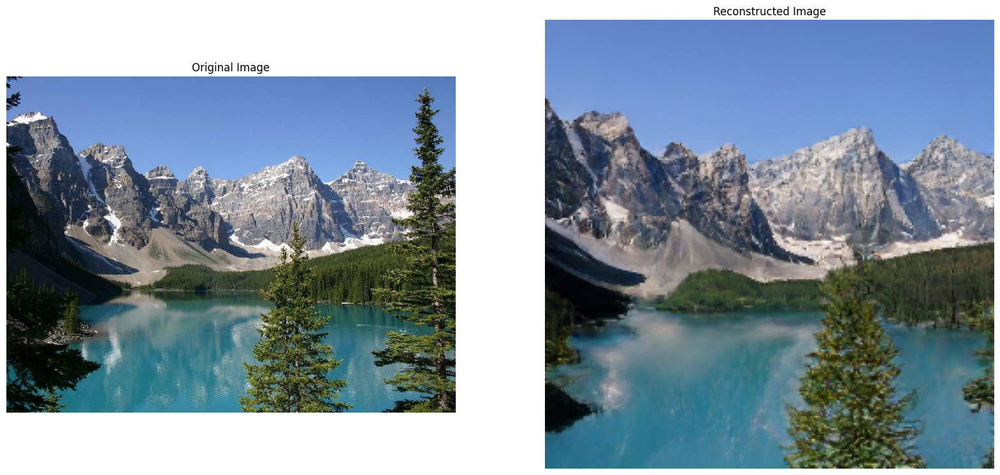

In [5]:
IMAGE_ID = "2883773_881c197107_c"

IMAGE_PATH = f"data/sflckr_images/canada/{IMAGE_ID}.jpg"

z, c_indices, x_rec = load_process_encode_rgb_image(IMAGE_PATH, vqgan_model, return_reconstruct=True, device=config.DEVICE)

print(f'⛳️ Image continuous latent vector Shape: {z.shape}')

show_original_and_reconstruction(IMAGE_PATH, x_rec)

## <span style='color:#ff5f27'> 🖼️ Segmentation Mask Encoding</span>


In [6]:
#config.PROMPT = "A beautiful morning city with many trees, lush green parks, and vibrant flowers, creating a picturesque and serene environment."

config.INITIAL_IMAGE = f"data/sflckr_segmentations/canada/{IMAGE_ID}.png"

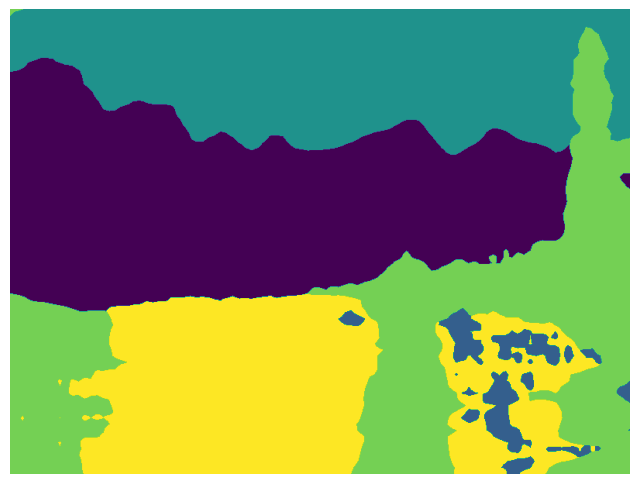

In [7]:
if config.INITIAL_IMAGE:
    show_pil_image(config.INITIAL_IMAGE)

In [8]:
clear_folder('sampling')

In [9]:
image_size = (config.WIDTH, config.HEIGHT)
image_size

(512, 512)

⛳️ Number of categories in segmentation image: 178
⛳️ Segmentation tensor shape: torch.Size([1, 182, 600, 800])


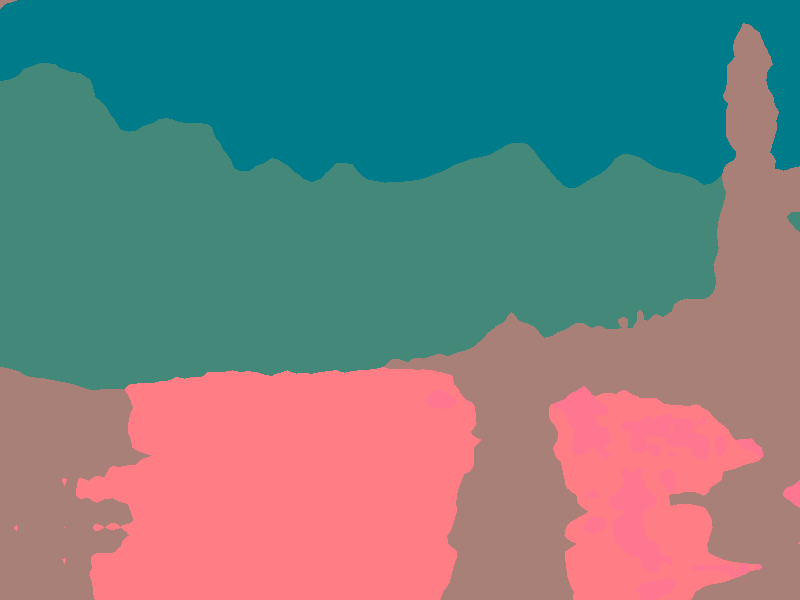

In [10]:
segmentation_tensor = load_and_process_segmentation(
    config.INITIAL_IMAGE, 
    plot_segmentation=True, 
    num_categories_expected=182,
)

> The indices tensor you're seeing represents the quantized indices of the latent vectors retrieved from either the initial image (if you provided one) or from random initialization (if no initial image was provided)

In [18]:
segmentation_tensor.shape

torch.Size([1, 182, 600, 800])

c_code torch.Size([1, 256, 37, 50]) torch.float32
c_indices torch.Size([1850]) torch.int64


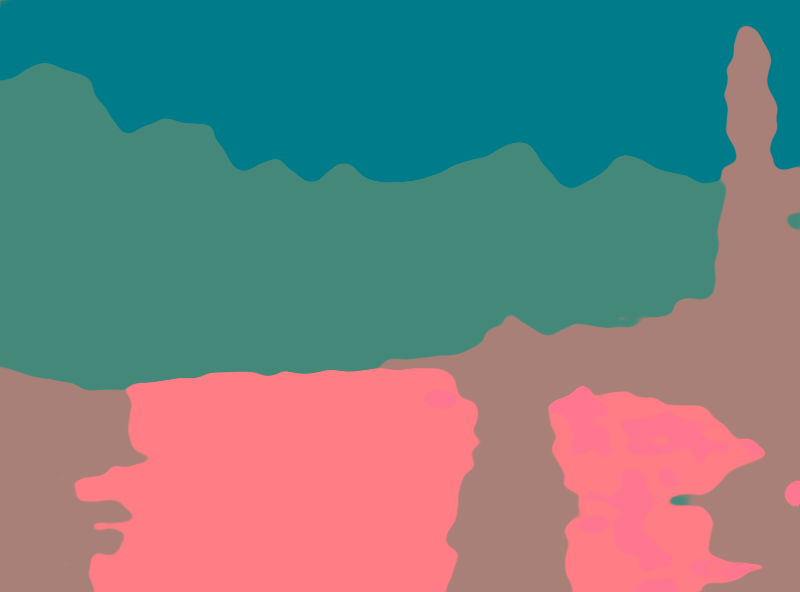

In [19]:
# Encode the segmentation
c_code, c_indices = vqgan_model.encode_to_c(segmentation_tensor)
print("c_code", c_code.shape, c_code.dtype)
print("c_indices", c_indices.shape, c_indices.dtype)
assert c_code.shape[2]*c_code.shape[3] == c_indices.shape[0]

# Decode and display the reconstructed segmentation
segmentation_rec = vqgan_model.cond_stage_model.decode(c_code)
show_segmentation(torch.softmax(segmentation_rec, dim=1))

In [20]:
c_code.shape

torch.Size([1, 256, 37, 50])

In [21]:
c_indices.shape

torch.Size([1850])

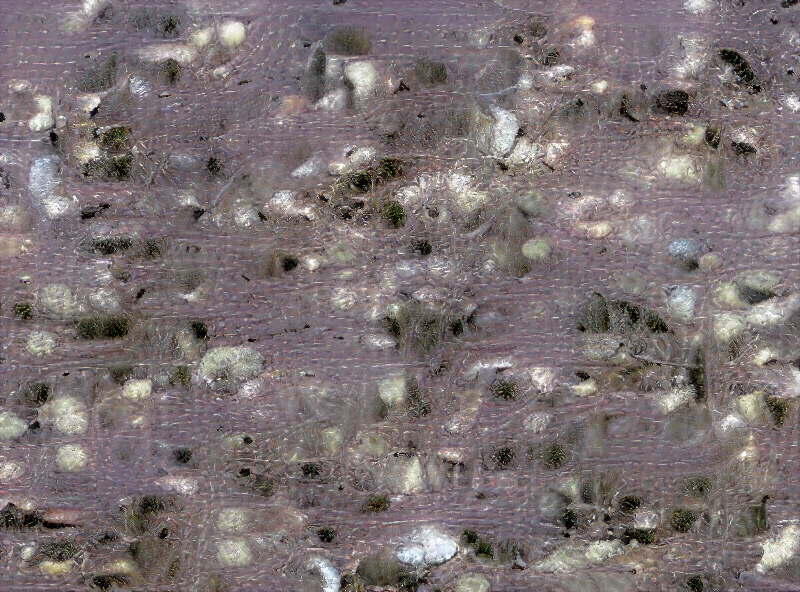

In [15]:
codebook_size = 256
z_indices_shape = c_indices.shape
z_code_shape = c_code.shape
z_indices = torch.randint(codebook_size, z_indices_shape, device=vqgan_model.device)
x_sample = vqgan_model.decode_to_img(z_indices, z_code_shape)
show_image(x_sample)

## <span style='color:#ff5f27'> 🔮 Image Generation</span>


🕰️ Time: 87.65 seconds
⛳️ Step: (36,49) | Local: (15,15) | Crop: (21:37,34:50)


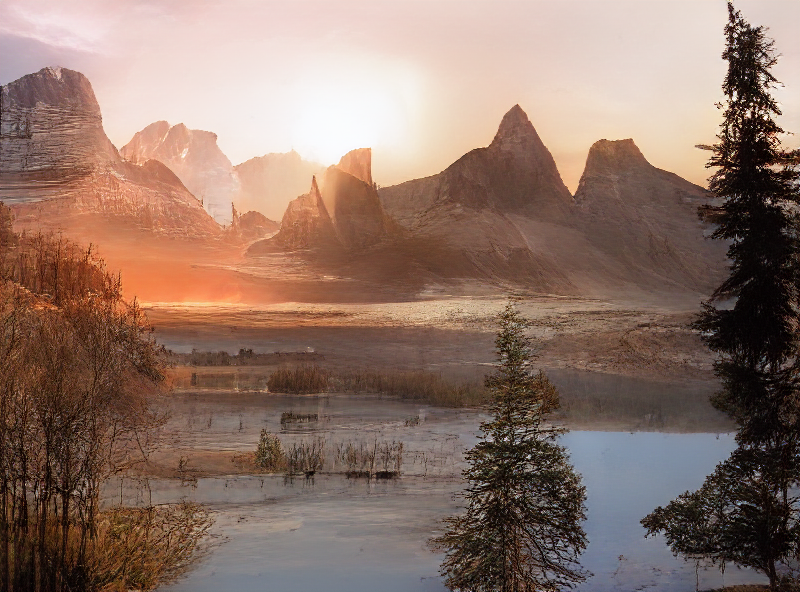

✅ All iterations completed.


In [16]:
image_generated = generate_image(
    vqgan_model, 
    config, 
    num_iterations=1,
    num_categories_expected=182,
)

## <span style='color:#ff5f27'> 🖼️ GIF Creation</span>


🔮 Total PNG files found: 38
💾 GIF saved to gifs/sflckr/canada.gif


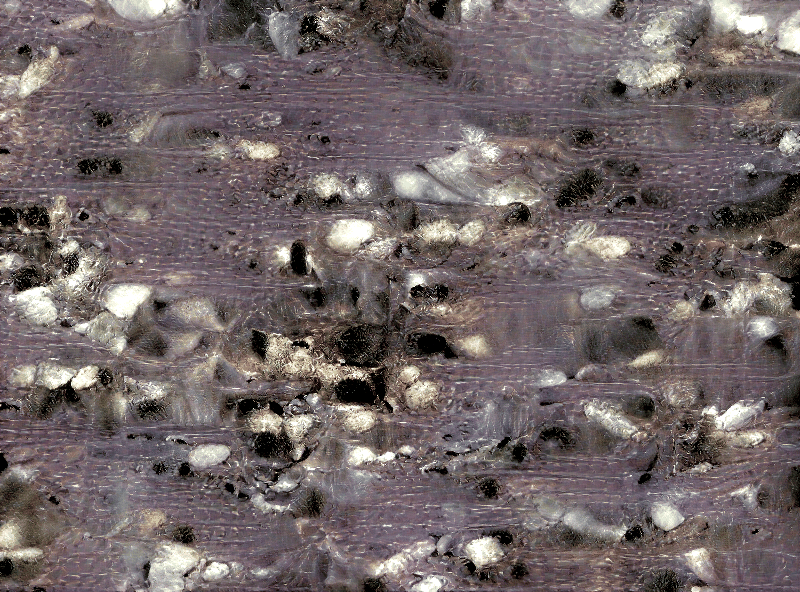

In [17]:
GIF_NAME = 'gifs/sflckr/canada.gif'

# Create GIF
create_gif(GIF_NAME, folder_path='sampling', duration=150)

# Display the GIF
play.display(play.Image(filename=GIF_NAME))

---